Aim: compute the overlap between prediced LigRec pairs in Spatial Transcriptomics data and in scRNA-Seq data of human lymph nodes.

A. Visium
1. Load Visium data
2. Normalize
3. Cluster Visium data
4. LigRec on Visium data

B. scRNA-Seq
1. Load data
2. Normalize
3. compute LigRec

C. compare
1. Venn-overlap between significant LigRecs
2. Are those overlap_ligrecs within or between clusters?
3. show expression of overlap_ligrecs

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import squidpy as sq
import seaborn as sns
import matplotlib.pyplot as plt
import scipy 
from scipy import stats

# A. visium data

In [2]:
# Load prestored Lymph Node Visium data set
visiumLN = sc.datasets.visium_sge('V1_Human_Lymph_Node')
visiumLN.var_names_make_unique()
visiumLN.var["mt"] = visiumLN.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(visiumLN, qc_vars=["mt"], inplace=True)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


<AxesSubplot:xlabel='n_genes_by_counts'>

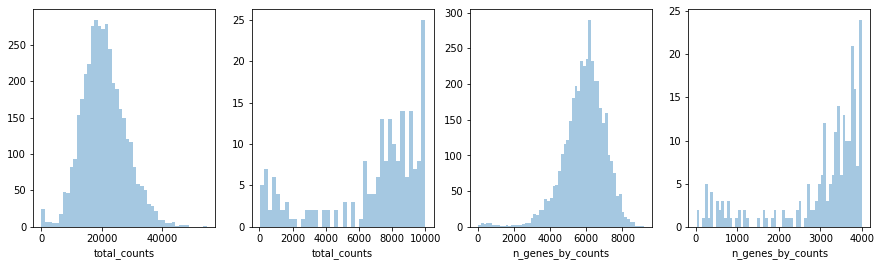

In [3]:
fig, axs = plt.subplots(1, 4, figsize=(15, 4))
sns.distplot(visiumLN.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(visiumLN.obs["total_counts"][visiumLN.obs["total_counts"] < 10000], kde=False, bins=40, ax=axs[1])
sns.distplot(visiumLN.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
sns.distplot(visiumLN.obs["n_genes_by_counts"][visiumLN.obs["n_genes_by_counts"] < 4000], kde=False, bins=60, ax=axs[3])

In [4]:
sc.pp.filter_cells(visiumLN, min_counts=5000)
sc.pp.filter_cells(visiumLN, max_counts=35000)
visiumLN = visiumLN[visiumLN.obs["pct_counts_mt"] < 20]
print(f"#cells after MT filter: {visiumLN.n_obs}")
sc.pp.filter_genes(visiumLN, min_cells=10)

#cells after MT filter: 3861


Trying to set attribute `.var` of view, copying.


In [5]:
# normalize
sc.pp.normalize_total(visiumLN, inplace=True)
sc.pp.log1p(visiumLN)
sc.pp.highly_variable_genes(visiumLN, flavor="seurat", n_top_genes=2000)

In [6]:
sc.pp.pca(visiumLN)
sc.pp.neighbors(visiumLN)
sc.tl.umap(visiumLN)
sc.tl.leiden(visiumLN, key_added="leiden_1")

... storing 'feature_types' as categorical
... storing 'genome' as categorical


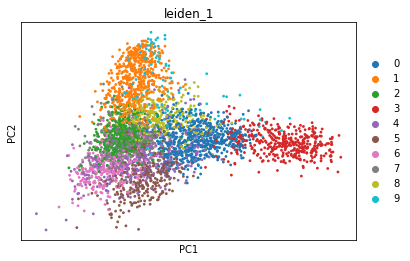

In [7]:
sc.pl.pca(visiumLN, color = "leiden_1")

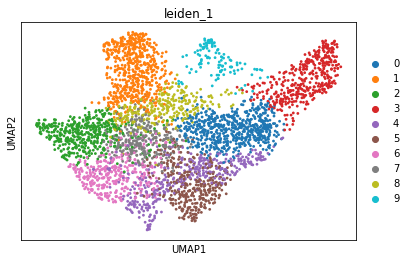

In [8]:
sc.pl.umap(visiumLN, color = "leiden_1")

In [9]:
sc.tl.tsne(visiumLN)

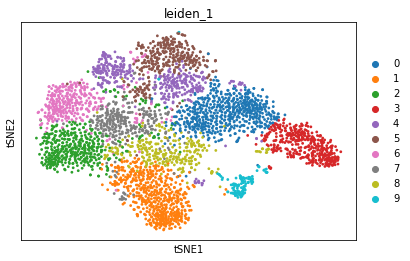

In [10]:
sc.pl.tsne(visiumLN,  color = "leiden_1")

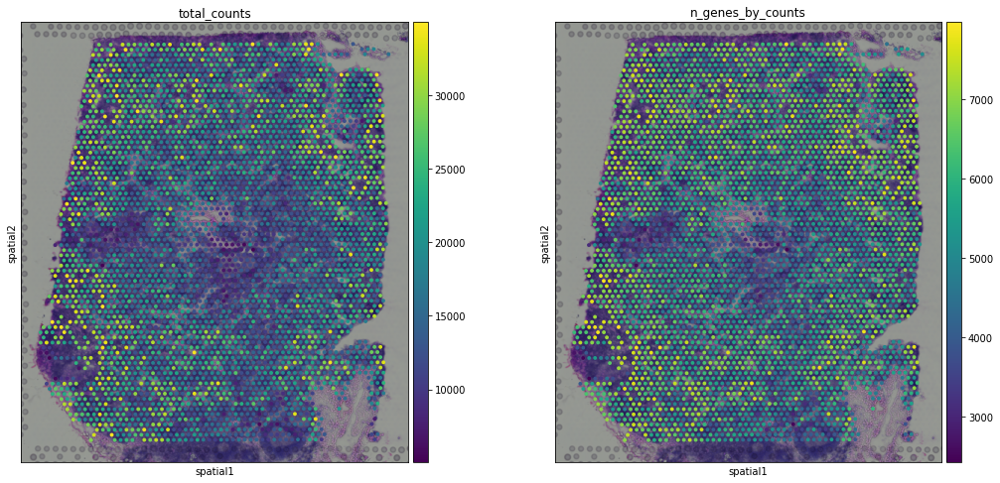

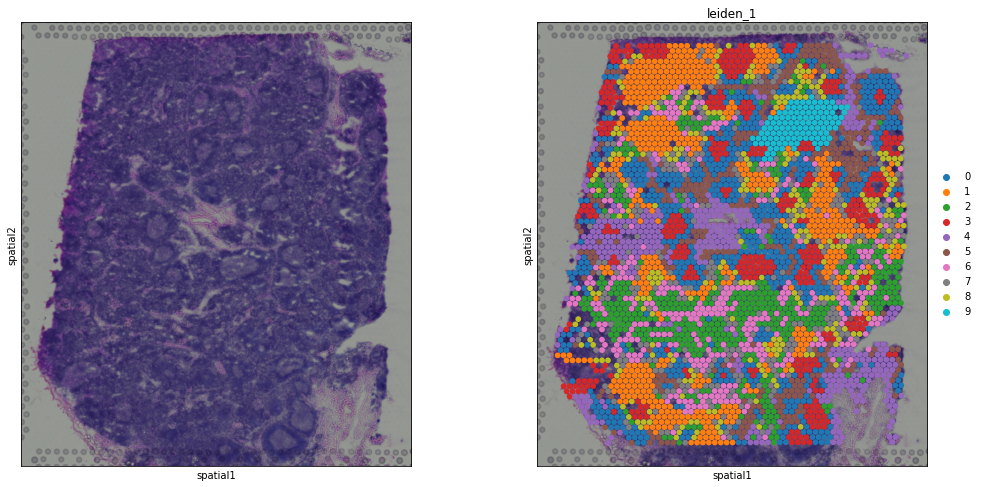

In [11]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=["total_counts", "n_genes_by_counts"])
sc.pl.spatial(visiumLN, img_key="hires", color=[None, "leiden_1"], size=1.5)

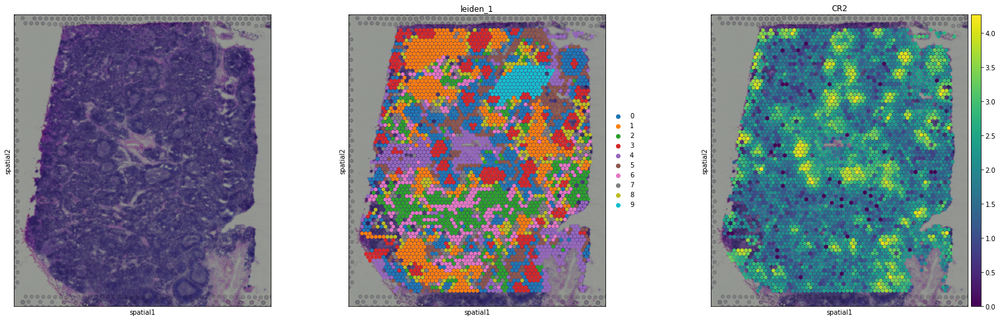

In [12]:
sc.pl.spatial(visiumLN, img_key="hires", color=[None, "leiden_1", "CR2"], size=1.5)

In [13]:
visiumLN.raw = visiumLN

In [14]:
# perform ligrec analysis
res_visium = sq.gr.ligrec(visiumLN, 
                          "leiden_1",
                          corr_method="fdr_bh", # cave: take care of proper multiple testing
                          interactions_params={"resources": "CellPhoneDB"},
                          alpha=0.05,
                          n_perms=10000,
                          copy =True,
                          threshold=0.1, 
                          seed=0, 
                          n_jobs=1,
                          show_progress_bar=True)

/opt/anaconda3/lib/python3.7/site-packages/omnipath/_core/requests/_utils.py:155: FutureWarning: The default value of regex will change from True to False in a future version.
  _split_unique_join(data.str.replace(r"[-\w]*:?(\d+)", r"\1")), func=func


  0%|          | 0/10000 [00:00<?, ?permutation/s]

In [15]:
res_visium["means"].head()

cluster_1             0                                                    \
cluster_2             0         1         2         3         4         5   
source target                                                               
JAG2   NOTCH1  0.481937  0.476287  0.431248  0.410684  0.403823  0.479777   
DLL1   NOTCH1  0.537315  0.531664  0.486625  0.466062  0.459201  0.535155   
JAG1   NOTCH1  0.513336  0.507686  0.462647  0.442083  0.435222  0.511176   
TNF    NOTCH1  0.524287  0.518636  0.473597  0.453034  0.446172  0.522127   
DLL4   NOTCH1  0.568858  0.563207  0.518168  0.497605  0.490743  0.566698   

cluster_1                                              ...         9  \
cluster_2             6         7         8         9  ...         0   
source target                                          ...             
JAG2   NOTCH1  0.465053  0.473382  0.466476  0.479872  ...  0.494785   
DLL1   NOTCH1  0.520430  0.528760  0.521853  0.535249  ...  0.556819   
JAG1   NOTCH1  0.496452  0.504781  0.497875  0.511271  ...  0.540001   
TNF    NOTCH1  0.507402  0.515732  0.508825  0.522221  ...  0.507983   
DLL4   NOTCH1  0.551973  0.560303  0.553396  0.566792  ...  0.583496   

cluster_1                                                                  \
cluster_2             1         2         3         4         5         6   
source target                                                               
JAG2   NOTCH1  0.489135  0.444096  0.423532  0.416671  0.492625  0.477901   
DLL1   NOTCH1  0.551169  0.506130  0.485566  0.478705  0.554659  0.539935   
JAG1   NOTCH1  0.534350  0.489311  0.468748  0.461886  0.537841  0.523116   
TNF    NOTCH1  0.502332  0.457293  0.436729  0.429868  0.505823  0.491098   
DLL4   NOTCH1  0.577845  0.532806  0.512243  0.505381  0.581336  0.566611   

cluster_1                                    
cluster_2             7         8         9  
source target                                
JAG2   NOTCH1  0.486230  0.479324  0.492720  
DLL1   NOTCH1  0.548264  0.541358  0.554754  
JAG1   NOTCH1  0.531446  0.524539  0.537935  
TNF    NOTCH1  0.499428  0.492521  0.505917  
DLL4   NOTCH1  0.574941  0.568034  0.581430  

[5 rows x 100 columns]

In [16]:
res_visium["pvalues"].head()

cluster_1       0                                                          \
cluster_2       0   1   2   3   4         5         6       7       8   9   
source target                                                               
JAG2   NOTCH1 NaN NaN NaN NaN NaN       NaN       NaN     NaN     NaN NaN   
DLL1   NOTCH1 NaN NaN NaN NaN NaN       NaN       NaN     NaN     NaN NaN   
JAG1   NOTCH1 NaN NaN NaN NaN NaN       NaN       NaN     NaN     NaN NaN   
TNF    NOTCH1 NaN NaN NaN NaN NaN  0.010533  0.132419  0.0711  0.5214 NaN   
DLL4   NOTCH1 NaN NaN NaN NaN NaN       NaN       NaN     NaN     NaN NaN   

cluster_1      ...       9                                                   \
cluster_2      ...       0        1   2   3   4         5   6         7   8   
source target  ...                                                            
JAG2   NOTCH1  ...     NaN      NaN NaN NaN NaN       NaN NaN       NaN NaN   
DLL1   NOTCH1  ...     NaN      NaN NaN NaN NaN       NaN NaN       NaN NaN   
JAG1   NOTCH1  ...     NaN      NaN NaN NaN NaN       NaN NaN       NaN NaN   
TNF    NOTCH1  ...  0.9796  0.93536 NaN NaN NaN  0.432206 NaN  0.670214 NaN   
DLL4   NOTCH1  ...     NaN      NaN NaN NaN NaN       NaN NaN       NaN NaN   

cluster_1          
cluster_2       9  
source target      
JAG2   NOTCH1 NaN  
DLL1   NOTCH1 NaN  
JAG1   NOTCH1 NaN  
TNF    NOTCH1 NaN  
DLL4   NOTCH1 NaN  

[5 rows x 100 columns]

Here, we are dealing with a sparse matrix. Are there any source-target combinations that only contain NaNs? If so, let's remove those!

In [17]:
print(res_visium["pvalues"].shape)
print(res_visium["pvalues"].dropna(axis=0, how='all').shape)

(316, 100)
(163, 100)


/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/sparse/array.py:1305: RuntimeWarning: invalid value encountered in double_scalars
  return sp_sum / ct


<AxesSubplot:>

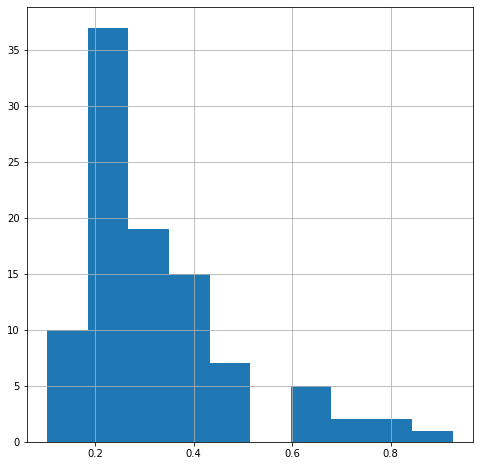

In [18]:
res_visium["pvalues"].dropna(axis=0, how='all').mean(axis=0).hist()

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


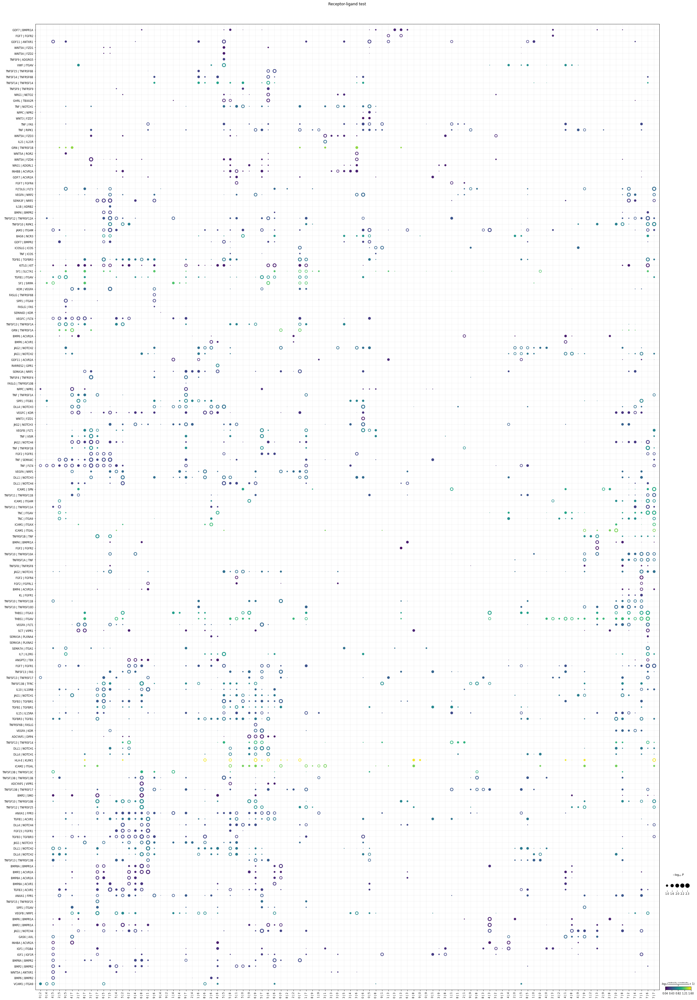

In [19]:
sq.pl.ligrec(res_visium,dendrogram = 'both',alpha = 0.05)

In [20]:
# for which ligrec pairs are there the most significant interactions?
min_list_visium = res_visium["pvalues"].dropna(axis=0, how='all').min(axis=1, skipna = True)
min_list_visium

source  target
JAG2    NOTCH1    0.010533
DLL1    NOTCH1    0.006320
JAG1    NOTCH1    0.010533
TNF     NOTCH1    0.010533
DLL4    NOTCH1    0.014044
                    ...   
THBS1   ITGAV     0.005267
VWF     ITGAV     0.009029
SPP1    ITGB1     0.010533
THBS1   ITGA3     0.005267
SEMA6D  KDR       0.438450
Length: 163, dtype: float64

<AxesSubplot:>

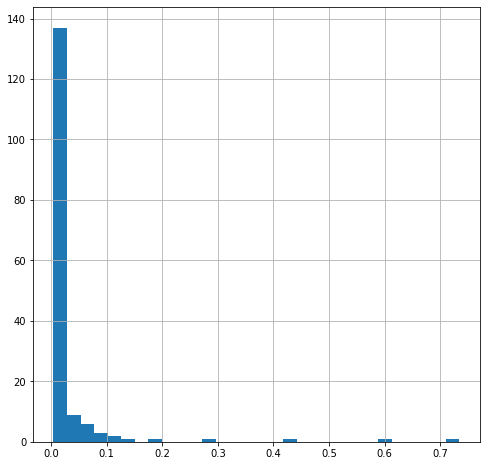

In [21]:
min_list_visium.hist(bins=30)

In [22]:
# select ligrec pairs with a minimum pvalue <0.075
sig_min_list_visium = min_list_visium[min_list_visium <0.075]
visium_sig_min_list = sig_min_list_visium.index
visium_sig_min_list

MultiIndex([( 'JAG2', 'NOTCH1'),
            ( 'DLL1', 'NOTCH1'),
            ( 'JAG1', 'NOTCH1'),
            (  'TNF', 'NOTCH1'),
            ( 'DLL4', 'NOTCH1'),
            ( 'JAG2', 'NOTCH2'),
            ( 'DLL1', 'NOTCH2'),
            ( 'JAG1', 'NOTCH2'),
            ( 'DLL4', 'NOTCH2'),
            ( 'JAG2', 'NOTCH3'),
            ...
            ('VCAM1',  'ITGA9'),
            ( 'SPP1',  'ITGA9'),
            (  'TNC',  'ITGA9'),
            ( 'BAG6',   'NCR3'),
            ('HLA-E',  'KLRK1'),
            ( 'SPP1',  'ITGAV'),
            ('THBS1',  'ITGAV'),
            (  'VWF',  'ITGAV'),
            ( 'SPP1',  'ITGB1'),
            ('THBS1',  'ITGA3')],
           names=['source', 'target'], length=152)

Let's visualize the expression of individual ligrec pairs as UMAP, spatial or violin plots.

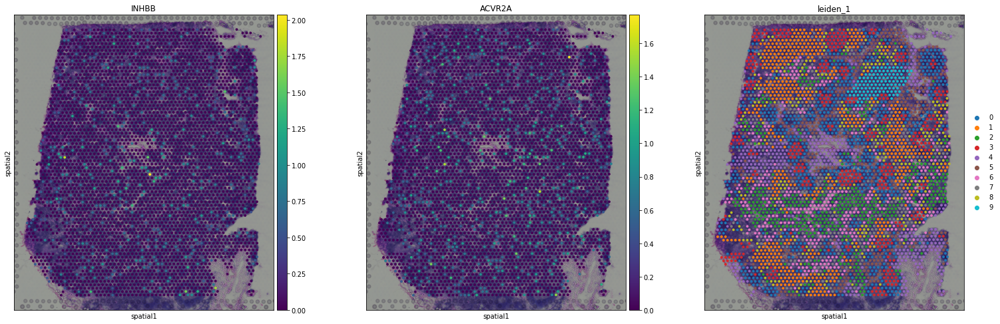

In [23]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=["INHBB", "ACVR2A", "leiden_1"])

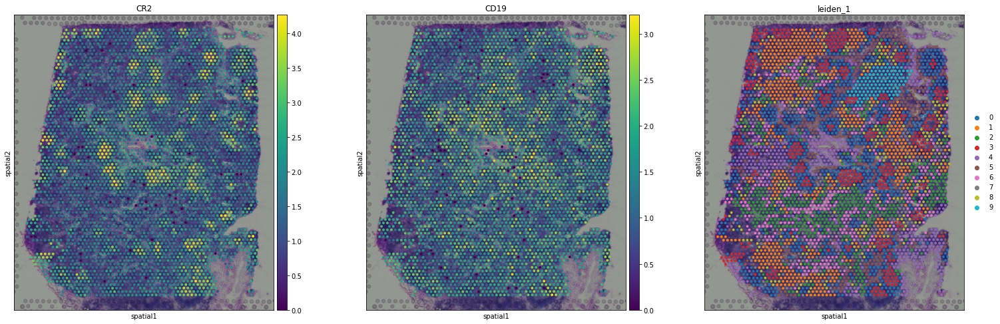

In [24]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=["CR2", "CD19", "leiden_1"])

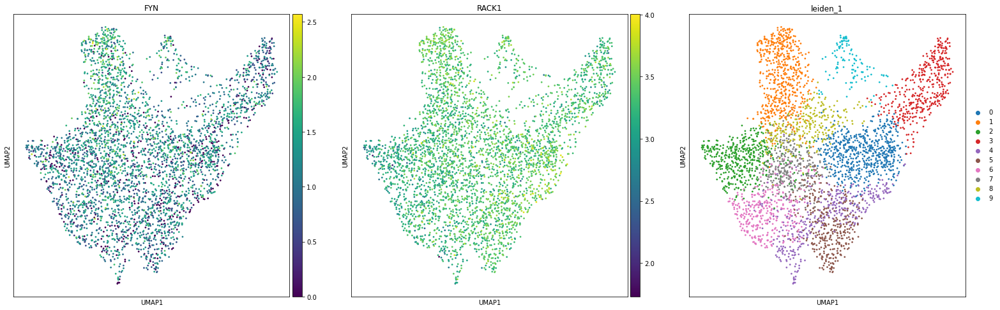

In [25]:
sc.pl.umap(visiumLN, color=["FYN", "RACK1", "leiden_1"])
#sc.pl.umap(visiumLN, color=["Cell_subtype"], wspace=0.4)

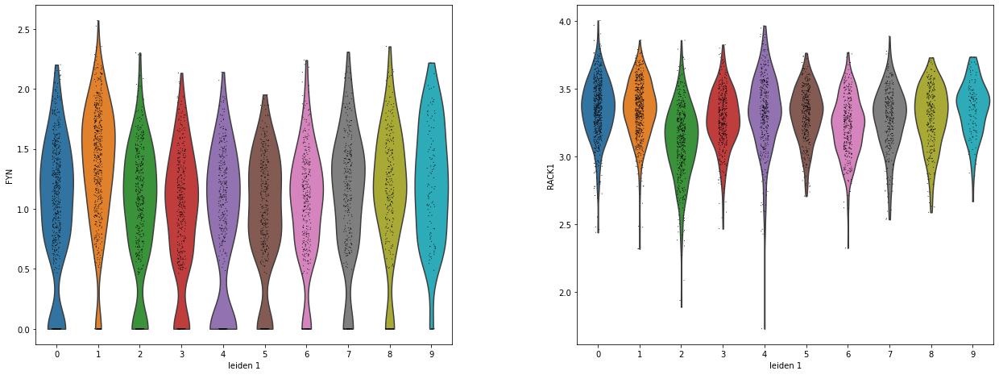

In [26]:
sc.pl.violin(visiumLN, ['FYN', 'RACK1'], groupby='leiden_1' )

# B. scRNA-Seq data

In [27]:
scLN = sc.read_csv("../02_data/02_processed_data/GSE131907_nLN_raw_UMI_matrix.csv")

In [28]:
# vars are supposed to be the genes, obs the cells
scLN = scLN.transpose()

In [29]:
# annotate scLN
annotation = pd.read_csv("../02_data/02_processed_data/GSE131907_Lung_Cancer_cell_annotation.txt", sep="\t")
annotation.index = annotation["Index"]

In [30]:
bool_ls = np.in1d(annotation["Index"], scLN.obs.index.values)

In [31]:
annotation = annotation.loc[bool_ls,]

In [32]:
scLN.obs["sample"] = annotation["Sample"]
scLN.obs["Sample_Origin"] = annotation["Sample_Origin"]
scLN.obs["Cell_type.refined"] = annotation["Cell_type.refined"]
scLN.obs["Cell_subtype"] = annotation["Cell_subtype"]

In [33]:
scLN.var_names_make_unique()  

In [34]:
scLN

AnnData object with n_obs × n_vars = 37446 × 29634
    obs: 'sample', 'Sample_Origin', 'Cell_type.refined', 'Cell_subtype'

In [35]:
# quality control
# mt RNA
scLN.var["mt"] = scLN.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(scLN, qc_vars=["mt"], inplace=True)

<AxesSubplot:xlabel='pct_counts_mt'>

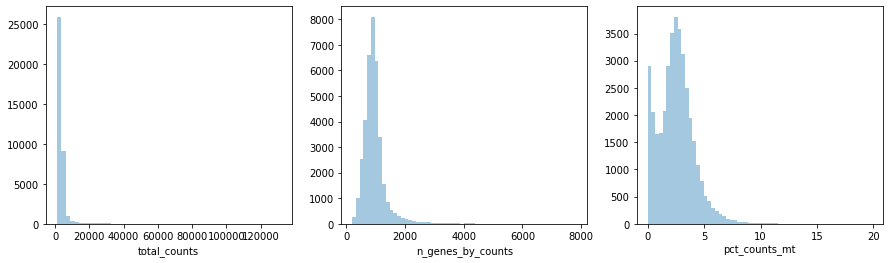

In [36]:
fig, axs = plt.subplots(1, 3, figsize=(15, 4))
sns.distplot(scLN.obs["total_counts"], kde=False, ax=axs[0])
sns.distplot(scLN.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[1])
sns.distplot(scLN.obs["pct_counts_mt"], kde=False, bins=60, ax=axs[2])

... storing 'sample' as categorical
... storing 'Sample_Origin' as categorical
... storing 'Cell_type.refined' as categorical
... storing 'Cell_subtype' as categorical


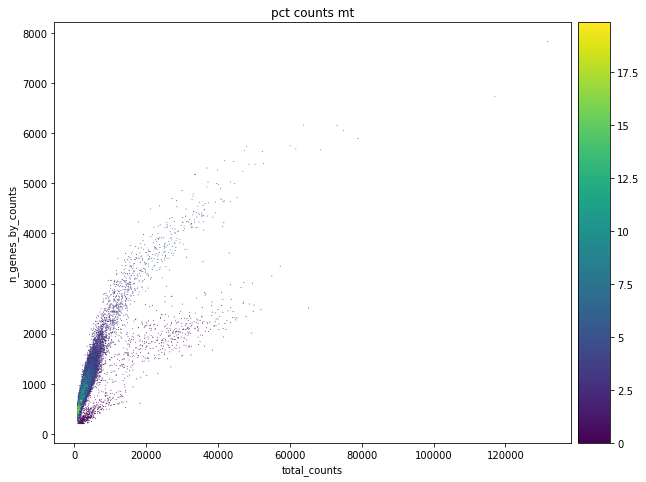

In [37]:
sc.pl.scatter(scLN, x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')

In [38]:
# remove outliers
scLN = scLN[scLN.obs.total_counts < 18000, :]
scLN = scLN[scLN.obs.n_genes_by_counts < 2000, :]
scLN = scLN[scLN.obs.pct_counts_mt < 7, :]

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


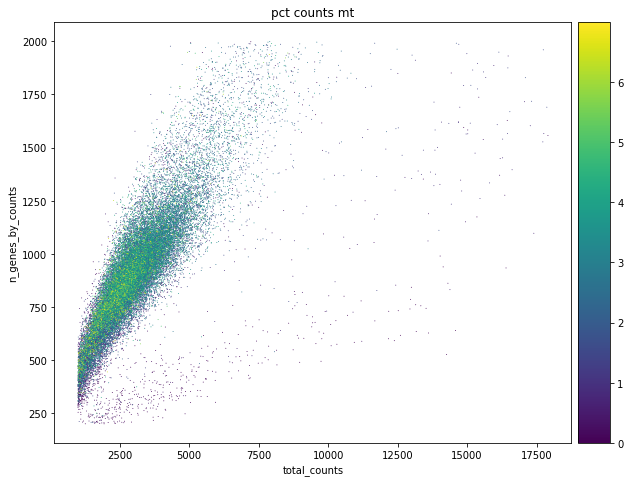

In [39]:
sc.pl.scatter(scLN, x='total_counts', y='n_genes_by_counts', color='pct_counts_mt')

In [40]:
# Normalize counts to 10,000 reads per cell
sc.pp.normalize_total(scLN, target_sum=1e4)

/opt/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_normalization.py:138: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [41]:
# Logarithmize the data
sc.pp.log1p(scLN)

In [42]:
# Identify highly variable genes
sc.pp.highly_variable_genes(scLN)

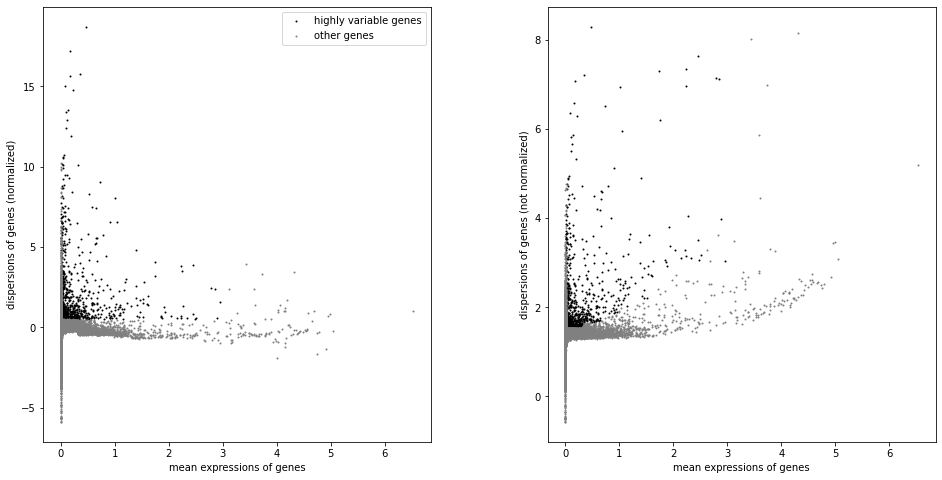

In [43]:
# equivalent to the DESeq2 MA-plot
sc.pl.highly_variable_genes(scLN)

In [44]:
scLN.raw = scLN

In [45]:
# proceed only with the highly variable genes
scLN = scLN[:, scLN.var.highly_variable]
# now we proceed with only 916 instead of 29634 genes

In [46]:
# scale data to unit variance
sc.pp.scale(scLN, max_value=10)

/opt/anaconda3/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [47]:
sc.tl.pca(scLN, svd_solver='arpack')

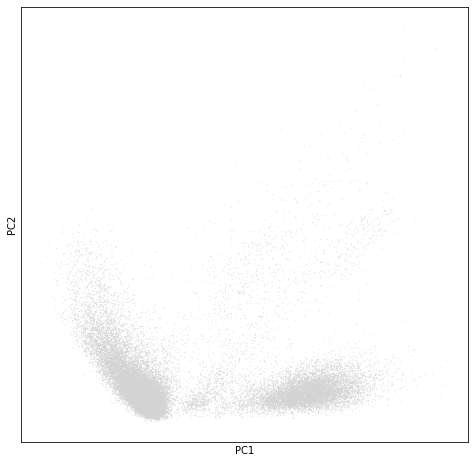

In [48]:
sc.pl.pca(scLN)

In [49]:
# compute the neighbors
sc.pp.neighbors(scLN)

In [50]:
# compute UMAP
sc.tl.umap(scLN)

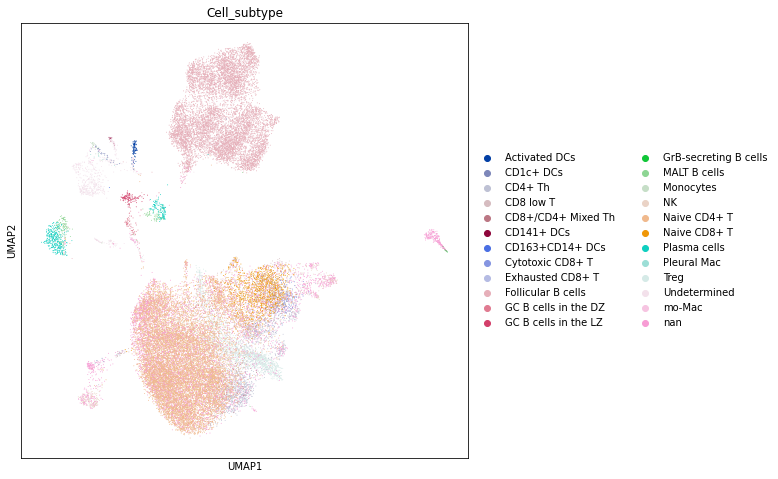

In [51]:
sc.pl.umap(scLN, color=["Cell_subtype"], wspace=0.4)

Compute LigRec with scRNA seq data

In [52]:
# compute all interactions for all samples
# perform ligrec analysis
res_scLN = sq.gr.ligrec(scLN, 
                          "Cell_subtype",
                          corr_method="fdr_bh", # cave: take care of proper multiple testing
                          interactions_params={"resources": "CellPhoneDB"},
                          alpha=0.05,
                          n_perms=10000,
                          copy =True,
                          threshold=0.1, 
                          seed=0, 
                          n_jobs=1,
                          show_progress_bar=True)

/opt/anaconda3/lib/python3.7/site-packages/omnipath/_core/requests/_utils.py:155: FutureWarning: The default value of regex will change from True to False in a future version.
  _split_unique_join(data.str.replace(r"[-\w]*:?(\d+)", r"\1")), func=func


  0%|          | 0/10000 [00:00<?, ?permutation/s]

In [53]:
print("Number of CellphoneDB interactions:", len(res_scLN["pvalues"]))

res_scLN["pvalues"].head()

Number of CellphoneDB interactions: 444


cluster_1     Activated DCs                                               \
cluster_2     Activated DCs CD141+ DCs CD163+CD14+ DCs CD1c+ DCs CD4+ Th   
source target                                                              
JAG2   NOTCH1           NaN        NaN             NaN       NaN     NaN   
DLL1   NOTCH1           NaN        NaN             NaN       NaN     NaN   
JAG1   NOTCH1           NaN        NaN             NaN       NaN     NaN   
TNF    NOTCH1           NaN        NaN             NaN       NaN     NaN   
DLL4   NOTCH1           NaN        NaN             NaN       NaN     NaN   

cluster_1                                                                     \
cluster_2     CD8 low T CD8+/CD4+ Mixed Th Cytotoxic CD8+ T Exhausted CD8+ T   
source target                                                                  
JAG2   NOTCH1       NaN                NaN              NaN              NaN   
DLL1   NOTCH1       NaN                NaN              NaN              NaN   
JAG1   NOTCH1       NaN                NaN              NaN              NaN   
TNF    NOTCH1       NaN                NaN              NaN              NaN   
DLL4   NOTCH1       NaN                NaN              NaN              NaN   

cluster_1                         ...       nan                                \
cluster_2     Follicular B cells  ... Monocytes  NK Naive CD4+ T Naive CD8+ T   
source target                     ...                                           
JAG2   NOTCH1                NaN  ...       NaN NaN          NaN          NaN   
DLL1   NOTCH1                NaN  ...       NaN NaN          NaN          NaN   
JAG1   NOTCH1                NaN  ...       NaN NaN          NaN          NaN   
TNF    NOTCH1                NaN  ...       NaN NaN          NaN          NaN   
DLL4   NOTCH1                NaN  ...       NaN NaN          NaN          NaN   

cluster_1                                                            
cluster_2     Plasma cells Pleural Mac Treg Undetermined mo-Mac nan  
source target                                                        
JAG2   NOTCH1          NaN         NaN  NaN          NaN    NaN NaN  
DLL1   NOTCH1          NaN         NaN  NaN          NaN    NaN NaN  
JAG1   NOTCH1          NaN         NaN  NaN          NaN    NaN NaN  
TNF    NOTCH1          NaN         NaN  NaN          NaN    NaN NaN  
DLL4   NOTCH1          NaN         NaN  NaN          NaN    NaN NaN  

[5 rows x 576 columns]

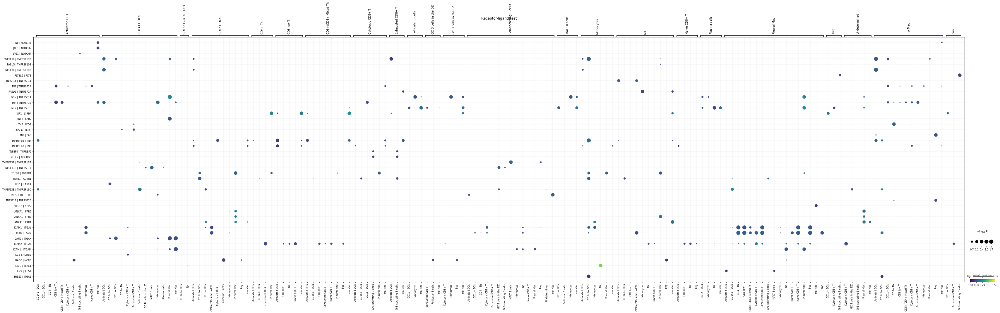

In [54]:
sq.pl.ligrec(res_scLN)

Now, we have a list of all predicted interactions between the cells of the scRNA-Seq data set.

This results file is just too big to properly interpret it.

In [55]:
# for which ligrec pairs are there the most significant interactions?
min_list_scLN = res_scLN["pvalues"].dropna(axis=0, how='all').min(axis=1, skipna = True)
min_list_scLN

source    target   
TNF       NOTCH1       0.1332
JAG1      NOTCH2       0.0888
          NOTCH4       0.4440
TNFSF10   TNFRSF10B    0.0222
FASLG     TNFRSF10B    0.6808
TNFSF10   TNFRSF11B    0.0222
FLT3LG    FLT3         0.0444
TNFSF14   TNFRSF14     0.0888
TNF       TNFRSF1A     0.0888
FASLG     TNFRSF1A     0.0444
GRN       TNFRSF1A     0.0222
TNF       TNFRSF1B     0.0444
GRN       TNFRSF1B     0.0444
SF1       SIRPA        0.0444
TNF       FFAR2        0.0296
          ICOS         0.0444
ICOSLG    ICOS         0.1776
TNF       FAS          0.0444
TNFRSF1B  TNF          0.0222
TNFRSF1A  TNF          0.0888
TNFSF9    TNFRSF9      0.2220
          ADGRG5       0.1554
TNFSF13B  TNFRSF13B    0.0444
          TNFRSF17     0.0444
TGFB1     TGFBR1       0.0444
          ACVR1        0.0444
IL15      IL15RA       0.0888
TNFSF13B  TNFRSF13C    0.0444
          TFRC         0.0444
TNFSF12   TNFRSF25     0.0888
VEGFA     NRP2         0.0888
ANXA1     FPR2         0.0666
          FPR3      

<AxesSubplot:>

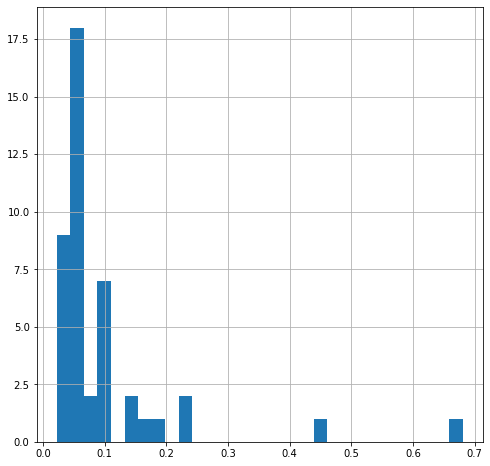

In [57]:
min_list_scLN.hist(bins=30)

In [58]:
# select ligrec pairs with a minimum pvalue <0.075
sig_min_list_scLN = min_list_scLN[min_list_scLN <0.075]
scLN_sig_min_list = sig_min_list_scLN.index
print(scLN_sig_min_list.shape)
scLN_sig_min_list

(29,)


MultiIndex([( 'TNFSF10', 'TNFRSF10B'),
            ( 'TNFSF10', 'TNFRSF11B'),
            (  'FLT3LG',      'FLT3'),
            (   'FASLG',  'TNFRSF1A'),
            (     'GRN',  'TNFRSF1A'),
            (     'TNF',  'TNFRSF1B'),
            (     'GRN',  'TNFRSF1B'),
            (     'SF1',     'SIRPA'),
            (     'TNF',     'FFAR2'),
            (     'TNF',      'ICOS'),
            (     'TNF',       'FAS'),
            ('TNFRSF1B',       'TNF'),
            ('TNFSF13B', 'TNFRSF13B'),
            ('TNFSF13B',  'TNFRSF17'),
            (   'TGFB1',    'TGFBR1'),
            (   'TGFB1',     'ACVR1'),
            ('TNFSF13B', 'TNFRSF13C'),
            ('TNFSF13B',      'TFRC'),
            (   'ANXA1',      'FPR2'),
            (   'ANXA1',      'FPR3'),
            (   'ANXA1',      'FPR1'),
            (   'ICAM1',     'ITGAL'),
            (   'ICAM1',       'SPN'),
            (   'ICAM1',     'ITGAX'),
            (   'ICAM2',     'ITGAL'),
            (   'ICAM1', 

# C. compare

In [59]:
intersection_set = set.intersection(set(scLN_sig_min_list), set(visium_sig_min_list))
print(len(intersection_set))
intersection_set

24


{('ANXA1', 'FPR1'),
 ('ANXA1', 'FPR3'),
 ('BAG6', 'NCR3'),
 ('FLT3LG', 'FLT3'),
 ('GRN', 'TNFRSF1A'),
 ('GRN', 'TNFRSF1B'),
 ('ICAM1', 'ITGAL'),
 ('ICAM1', 'ITGAM'),
 ('ICAM1', 'ITGAX'),
 ('ICAM1', 'SPN'),
 ('ICAM2', 'ITGAL'),
 ('SF1', 'SIRPA'),
 ('TGFB1', 'ACVR1'),
 ('TGFB1', 'TGFBR1'),
 ('THBS1', 'ITGA3'),
 ('TNF', 'FAS'),
 ('TNF', 'TNFRSF1B'),
 ('TNFRSF1B', 'TNF'),
 ('TNFSF10', 'TNFRSF10B'),
 ('TNFSF10', 'TNFRSF11B'),
 ('TNFSF13B', 'TFRC'),
 ('TNFSF13B', 'TNFRSF13B'),
 ('TNFSF13B', 'TNFRSF13C'),
 ('TNFSF13B', 'TNFRSF17')}

In [61]:
res_visium["pvalues"].loc[intersection_set]

cluster_1            0                                                \
cluster_2            0         1   2   3       4         5         6   
source   target                                                        
TNFSF13B TNFRSF13C NaN       NaN NaN NaN     NaN  0.297943       NaN   
FLT3LG   FLT3      NaN       NaN NaN NaN     NaN       NaN       NaN   
ICAM1    ITGAM     NaN       NaN NaN NaN     NaN       NaN       NaN   
TNF      TNFRSF1B  NaN       NaN NaN NaN     NaN       NaN       NaN   
TNFRSF1B TNF       NaN       NaN NaN NaN     NaN       NaN       NaN   
TNFSF10  TNFRSF11B NaN       NaN NaN NaN     NaN       NaN       NaN   
TGFB1    TGFBR1    NaN  0.052667 NaN NaN     NaN  0.201242       NaN   
TNFSF13B TFRC      NaN       NaN NaN NaN     NaN       NaN       NaN   
ANXA1    FPR1      NaN       NaN NaN NaN     NaN       NaN       NaN   
TGFB1    ACVR1     NaN  0.068467 NaN NaN     NaN       NaN  0.132419   
TNFSF13B TNFRSF17  NaN       NaN NaN NaN     NaN       NaN       NaN   
ANXA1    FPR3      NaN       NaN NaN NaN     NaN       NaN       NaN   
TNFSF10  TNFRSF10B NaN       NaN NaN NaN     NaN       NaN       NaN   
ICAM2    ITGAL     NaN       NaN NaN NaN     NaN       NaN       NaN   
TNF      FAS       NaN       NaN NaN NaN     NaN  0.031600  0.051350   
TNFSF13B TNFRSF13B NaN       NaN NaN NaN     NaN       NaN       NaN   
GRN      TNFRSF1A  NaN       NaN NaN NaN     NaN       NaN       NaN   
ICAM1    ITGAL     NaN       NaN NaN NaN     NaN       NaN       NaN   
GRN      TNFRSF1B  NaN       NaN NaN NaN     NaN       NaN       NaN   
SF1      SIRPA     NaN       NaN NaN NaN  0.1817       NaN       NaN   
ICAM1    SPN       NaN  0.966960 NaN NaN     NaN       NaN       NaN   
         ITGAX     NaN       NaN NaN NaN     NaN       NaN       NaN   
BAG6     NCR3      NaN       NaN NaN NaN     NaN  0.042133  0.101822   
THBS1    ITGA3     NaN       NaN NaN NaN     NaN       NaN       NaN   

cluster_1                                        ...       9            \
cluster_2                  7         8        9  ...       0         1   
source   target                                  ...                     
TNFSF13B TNFRSF13C       NaN       NaN      NaN  ...     NaN       NaN   
FLT3LG   FLT3            NaN       NaN      NaN  ...  0.9796       NaN   
ICAM1    ITGAM           NaN       NaN      NaN  ...     NaN       NaN   
TNF      TNFRSF1B        NaN       NaN      NaN  ...     NaN       NaN   
TNFRSF1B TNF             NaN       NaN      NaN  ...     NaN       NaN   
TNFSF10  TNFRSF11B       NaN       NaN      NaN  ...     NaN       NaN   
TGFB1    TGFBR1          NaN       NaN      NaN  ...     NaN  0.935360   
TNFSF13B TFRC            NaN       NaN      NaN  ...     NaN  0.015800   
ANXA1    FPR1            NaN       NaN      NaN  ...     NaN       NaN   
TGFB1    ACVR1           NaN       NaN      NaN  ...     NaN       NaN   
TNFSF13B TNFRSF17        NaN       NaN      NaN  ...     NaN       NaN   
ANXA1    FPR3            NaN       NaN      NaN  ...     NaN  0.288914   
TNFSF10  TNFRSF10B       NaN       NaN      NaN  ...     NaN       NaN   
ICAM2    ITGAL           NaN  0.580086      NaN  ...     NaN       NaN   
TNF      FAS        0.292643       NaN  0.73312  ...     NaN  0.023700   
TNFSF13B TNFRSF13B       NaN       NaN      NaN  ...     NaN       NaN   
GRN      TNFRSF1A   0.026333       NaN      NaN  ...     NaN       NaN   
ICAM1    ITGAL           NaN       NaN      NaN  ...     NaN  0.529300   
GRN      TNFRSF1B   0.233238       NaN      NaN  ...     NaN       NaN   
SF1      SIRPA      0.044767       NaN      NaN  ...     NaN       NaN   
ICAM1    SPN             NaN       NaN      NaN  ...     NaN       NaN   
         ITGAX           NaN       NaN      NaN  ...     NaN       NaN   
BAG6     NCR3            NaN       NaN      NaN  ...  0.5688       NaN   
THBS1    ITGA3           NaN       NaN      NaN  ...     NaN       NaN   

cluster_1                                               

In [62]:
res_ligrec_merge = res_visium.copy()
res_ligrec_merge["pvalues"] = res_visium["pvalues"].loc[intersection_set].merge(res_scLN["pvalues"].loc[intersection_set], left_index=True, right_on=['source', 'target'])
res_ligrec_merge["means"] = res_visium["means"].loc[intersection_set].merge(res_scLN["means"].loc[intersection_set], left_index=True, right_on=['source', 'target'])
res_ligrec_merge["metadata"] = res_visium["metadata"].loc[intersection_set].merge(res_scLN["metadata"].loc[intersection_set], left_index=True, right_on=['source', 'target'])

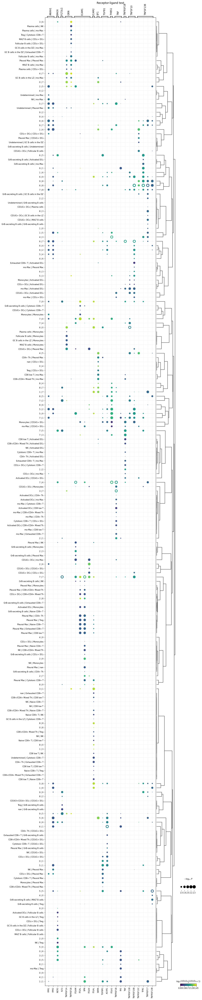

In [63]:
sq.pl.ligrec(res_ligrec_merge,dendrogram = 'interacting_clusters',alpha = 0.01)

So what does this visualization tell us?  
It displays the ligrecs that are significant in both datasets and projects the interaction partners on the x axis.  
Therefore, we could speculate that we can now match visium cluster interactions with underlying annotated cell-cell pairs.

It turns out, that this is not very easily interpretable. 

**Let's see if we can make things clearer if we only take samples for which the clusters interact in themselves!**

In [64]:
self_interact = [('0', '0'), 
               ('1', '1'),
               ('2', '2'),
               ('3', '3'),
               ('4', '4'),
               ('5', '5'),
               ('6', '6'),
               ('7', '7'),
               ('8', '8'),
               ('9', '9')]

In [65]:
res_visium_self = res_visium.copy()
res_visium_self["pvalues"] = res_visium["pvalues"][self_interact]
res_visium_self["means"] = res_visium["means"][self_interact]
res_visium_self["metadata"] = res_visium["metadata"]

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


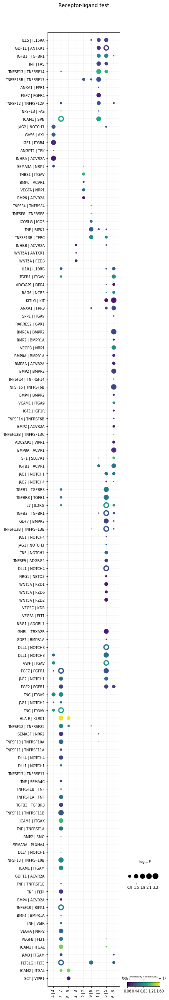

In [66]:
sq.pl.ligrec(res_visium_self,dendrogram = 'both',alpha = 0.01)

In [67]:
min_list_visium_self = res_visium_self["pvalues"].dropna(axis=0, how='all').min(axis=1, skipna = True)
sig_min_list_visium_self = min_list_visium_self[min_list_visium_self <0.075]
visium_self_sig_min_list = sig_min_list_visium_self.index
print(visium_self_sig_min_list.shape)
visium_self_sig_min_list

(62,)


MultiIndex([(    'JAG2',    'NOTCH1'),
            (    'JAG2',    'NOTCH3'),
            (    'DLL1',    'NOTCH3'),
            (    'DLL4',    'NOTCH3'),
            (    'DLL1',    'NOTCH4'),
            (    'DLL4',    'NOTCH4'),
            (    'IGF1',     'ITGB4'),
            (   'WNT5A',      'FZD2'),
            (   'WNT5A',      'FZD1'),
            (   'GDF11',    'ANTXR1'),
            ( 'TNFSF10', 'TNFRSF10B'),
            ( 'TNFSF10', 'TNFRSF10A'),
            ( 'TNFSF11', 'TNFRSF11B'),
            ( 'TNFSF10',     'RIPK1'),
            (     'TNF',     'RIPK1'),
            (  'FLT3LG',      'FLT3'),
            (   'KITLG',       'KIT'),
            ( 'TNFSF13',  'TNFRSF14'),
            ( 'TNFSF15',  'TNFRSF6B'),
            (     'TNF',  'TNFRSF1A'),
            (     'TNF',      'FLT4'),
            (     'TNF',       'FAS'),
            ('TNFRSF1A',       'TNF'),
            ('TNFSF13B', 'TNFRSF13B'),
            ('TNFSF13B',  'TNFRSF17'),
            (   'TGFB1', 

In [68]:
intersection_set_self = set.intersection(set(scLN_sig_min_list), set(visium_self_sig_min_list))
print(len(intersection_set_self))
intersection_set_self

14


{('ANXA1', 'FPR3'),
 ('FLT3LG', 'FLT3'),
 ('ICAM1', 'ITGAL'),
 ('ICAM1', 'ITGAM'),
 ('ICAM1', 'ITGAX'),
 ('ICAM1', 'SPN'),
 ('ICAM2', 'ITGAL'),
 ('TGFB1', 'ACVR1'),
 ('TGFB1', 'TGFBR1'),
 ('TNF', 'FAS'),
 ('TNFSF10', 'TNFRSF10B'),
 ('TNFSF13B', 'TFRC'),
 ('TNFSF13B', 'TNFRSF13B'),
 ('TNFSF13B', 'TNFRSF17')}

In [124]:
print(len(scLN_sig_min_list))
print(len(visium_self_sig_min_list))
print(len(intersection_set_self))

29
62
14


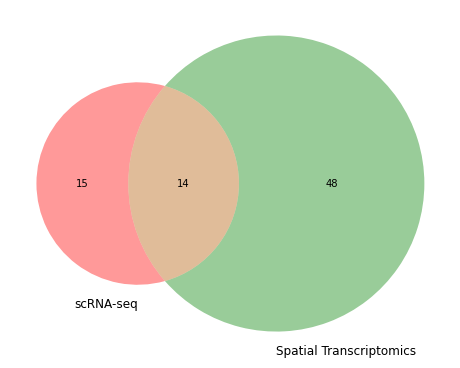

In [125]:
from matplotlib_venn import venn2

venn2(subsets = (len(scLN_sig_min_list) - len(intersection_set_self),
                 len(visium_self_sig_min_list) - len(intersection_set_self),
                 len(intersection_set_self)), set_labels = ('scRNA-seq', 'Spatial Transcriptomics'))

In [69]:
res_ligrec_merge_self = res_visium_self.copy()
res_ligrec_merge_self["pvalues"] = res_visium_self["pvalues"].loc[intersection_set_self].merge(res_scLN["pvalues"].loc[intersection_set_self], left_index=True, right_on=['source', 'target'])
res_ligrec_merge_self["means"] = res_visium_self["means"].loc[intersection_set_self].merge(res_scLN["means"].loc[intersection_set_self], left_index=True, right_on=['source', 'target'])
res_ligrec_merge_self["metadata"] = res_visium_self["metadata"].loc[intersection_set_self].merge(res_scLN["metadata"].loc[intersection_set_self], left_index=True, right_on=['source', 'target'])

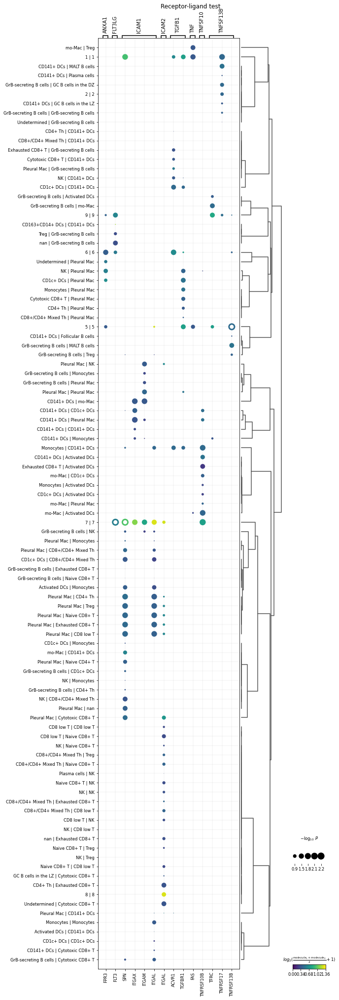

In [70]:
sq.pl.ligrec(res_ligrec_merge_self,dendrogram = 'interacting_clusters',alpha = 0.01)

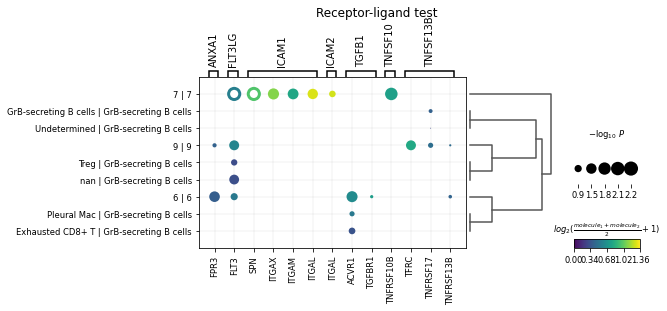

In [172]:
# define target groups for visualization purposes
# for visualiztation purposes the image is cropped later.
sq.pl.ligrec(res_ligrec_merge_self,dendrogram = 'interacting_clusters',alpha = 0.01,
            target_groups = ["GrB-secreting B cells", "9", "6", "7"])

In [71]:
# get a list of individual genes from the intersection list
genes_of_interest = list()

for i in intersection_set_self:
    first = i[0]
    second = i[1]
    genes_of_interest.append(first)
    genes_of_interest.append(second)
    

# remove duplicated gene names
genes_of_interest = set(genes_of_interest)
genes_of_interest = list(genes_of_interest)

In [72]:
visium_select = visiumLN[:,genes_of_interest]
visium_select.var

/opt/anaconda3/lib/python3.7/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


,gene_ids,feature_types,genome,mt,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_cells,highly_variable,means,dispersions,dispersions_norm
ITGAM,ENSG00000169896,Gene Expression,GRCh38,False,1257,0.406444,0.341064,68.847584,1640.0,7.403061,1189,False,0.332722,0.204637,0.666507
TNFRSF17,ENSG00000048462,Gene Expression,GRCh38,False,1641,0.573482,0.453291,59.330855,2314.0,7.747165,1560,False,0.435214,0.159115,0.150769
TNFSF13B,ENSG00000102524,Gene Expression,GRCh38,False,1618,0.553903,0.440770,59.900867,2235.0,7.712444,1537,False,0.428591,0.172733,0.305054
ANXA1,ENSG00000135046,Gene Expression,GRCh38,False,2135,0.857993,0.619497,47.087980,3462.0,8.149891,2037,True,0.606861,0.236806,1.030971
ITGAL,ENSG00000005844,Gene Expression,GRCh38,False,3884,4.643123,1.730438,3.742255,18735.0,9.838202,3741,False,1.712206,0.270424,-0.168924
FPR3,ENSG00000187474,Gene Expression,GRCh38,False,459,0.125651,0.118361,88.624535,507.0,6.230482,426,False,0.108856,0.077272,-0.487425
ICAM1,ENSG00000090339,Gene Expression,GRCh38,False,3539,2.714498,1.312244,12.292441,10953.0,9.301460,3404,True,1.283459,0.411637,1.276435
TGFBR1,ENSG00000106799,Gene Expression,GRCh38,False,2049,0.763073,0.567058,49.219331,3079.0,8.032685,1951,False,0.554332,0.142286,-0.039897
TNFSF10,ENSG00000121858,Gene Expression,GRCh38,False,2747,1.405700,0.877841,31.920694,5672.0,8.643474,2629,True,0.851393,0.375770,2.068002
TNF,ENSG00000232810,Gene Expression,GRCh38,False,721,0.201239,0.183354,82.131351,812.0,6.700731,685,False,0.180415,0.115453,-0.070135


In [73]:
gxc_dense = visium_select.X.todense()
gxc_dense.shape

(3861, 21)

In [74]:
gxc_dense_df = pd.DataFrame(gxc_dense,columns=visium_select.var.index.values)
gxc_dense_df

,ITGAM,TNFRSF17,TNFSF13B,ANXA1,ITGAL,FPR3,ICAM1,TGFBR1,TNFSF10,TNF,...,ACVR1,SPN,ITGAX,FLT3,TFRC,ICAM2,TNFRSF13B,FAS,TGFB1,TNFRSF10B
0,0.540963,0.890079,0.540963,0.000000,1.668831,0.0,0.540963,1.353420,1.148349,0.00000,...,0.000000,0.890079,0.540963,0.000000,0.540963,0.890079,0.000000,0.540963,0.000000,0.000000
1,0.000000,0.000000,0.577110,0.577110,1.590138,0.0,0.940698,0.940698,0.940698,0.57711,...,0.940698,1.206765,0.940698,0.577110,1.206765,1.206765,0.577110,0.000000,1.206765,0.577110
2,0.000000,0.000000,0.487543,0.487543,1.421070,0.0,0.813868,0.487543,2.068306,0.00000,...,0.000000,0.487543,1.059501,0.487543,1.256539,1.562317,0.487543,0.000000,0.487543,0.000000
3,0.000000,0.499758,0.000000,0.831449,2.012663,0.0,1.080097,0.000000,0.831449,0.00000,...,0.000000,0.831449,1.279067,0.000000,0.831449,0.831449,0.000000,0.499758,0.000000,1.444943
4,0.000000,0.489888,0.817251,0.489888,1.260882,0.0,0.817251,0.000000,0.489888,0.00000,...,0.817251,1.063468,0.489888,0.000000,0.489888,1.567115,0.489888,0.489888,0.817251,1.260882
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3856,0.000000,0.703402,0.000000,0.703402,1.401638,0.0,1.112263,1.112263,1.401638,0.00000,...,0.000000,0.703402,0.703402,0.000000,0.000000,0.703402,0.000000,0.703402,1.401638,0.703402
3857,0.000000,0.657702,1.051067,0.657702,1.552106,0.0,1.731966,1.051067,0.657702,0.00000,...,1.051067,1.051067,1.332644,0.000000,0.000000,1.552106,0.657702,1.332644,0.657702,0.657702
3858,1.311841,0.000000,0.644133,0.000000,1.311841,0.0,1.311841,1.032711,1.529818,0.00000,...,0.644133,0.000000,1.992022,1.311841,1.860353,1.529818,1.032711,1.032711,1.708681,1.311841
3859,0.000000,0.000000,0.968731,0.000000,1.775596,0.0,0.000000,0.000000,1.451426,0.00000,...,0.968731,1.451426,0.000000,0.000000,0.968731,1.451426,0.968731,0.000000,0.968731,0.000000


In [151]:
gxc_dense_df.corr().loc["FLT3"]


ITGAM       -0.017824
TNFRSF17    -0.022437
TNFSF13B     0.062719
ANXA1        0.047108
ITGAL        0.057709
FPR3         0.014364
ICAM1        0.023452
TGFBR1       0.041975
TNFSF10      0.039155
TNF          0.000695
FLT3LG       0.077914
ACVR1       -0.010248
SPN          0.061141
ITGAX        0.030387
FLT3         1.000000
TFRC         0.002093
ICAM2        0.009145
TNFRSF13B   -0.003433
FAS          0.008388
TGFB1        0.047237
TNFRSF10B    0.004319
Name: FLT3, dtype: float64

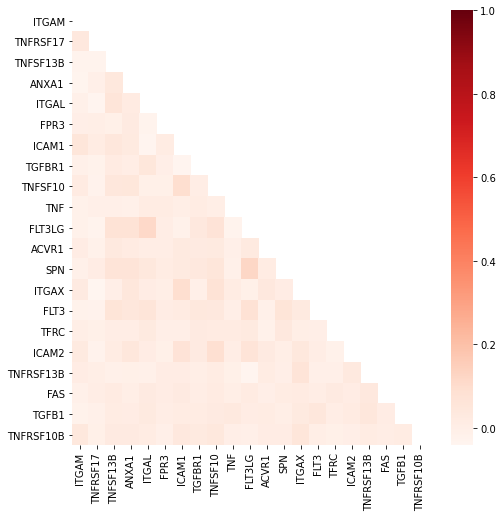

In [114]:
mask = np.triu(np.ones_like(gxc_dense_df.corr(), dtype=bool))
sns.heatmap(gxc_dense_df.corr(), annot=False, cmap = 'Reds', mask=mask)
plt.show()

These correlation results do not recapitulate the predicted receptor-ligand partners. Therefore, let's look at the correlations within clusters instead of within spots!

In [87]:
intersection_set_self

{('ANXA1', 'FPR3'),
 ('FLT3LG', 'FLT3'),
 ('ICAM1', 'ITGAL'),
 ('ICAM1', 'ITGAM'),
 ('ICAM1', 'ITGAX'),
 ('ICAM1', 'SPN'),
 ('ICAM2', 'ITGAL'),
 ('TGFB1', 'ACVR1'),
 ('TGFB1', 'TGFBR1'),
 ('TNF', 'FAS'),
 ('TNFSF10', 'TNFRSF10B'),
 ('TNFSF13B', 'TFRC'),
 ('TNFSF13B', 'TNFRSF13B'),
 ('TNFSF13B', 'TNFRSF17')}

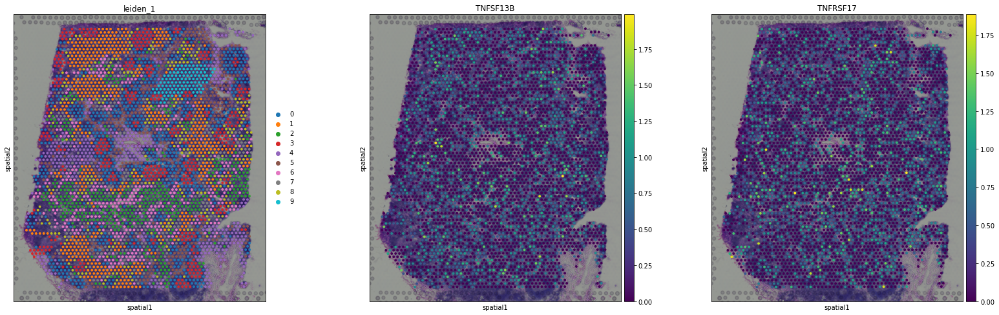

In [138]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=['leiden_1', 'TNFSF13B', 'TNFRSF17'])

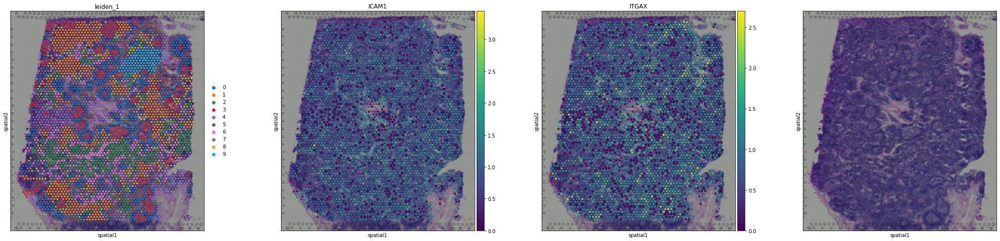

In [139]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=['leiden_1', 'ICAM1', 'ITGAX', None])

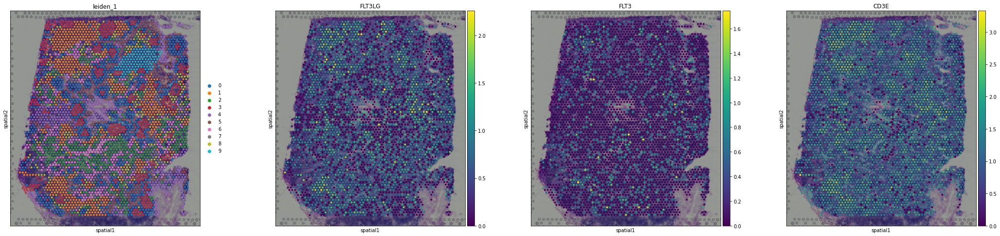

In [143]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=['leiden_1', 'FLT3LG', 'FLT3', 'CD3E'])

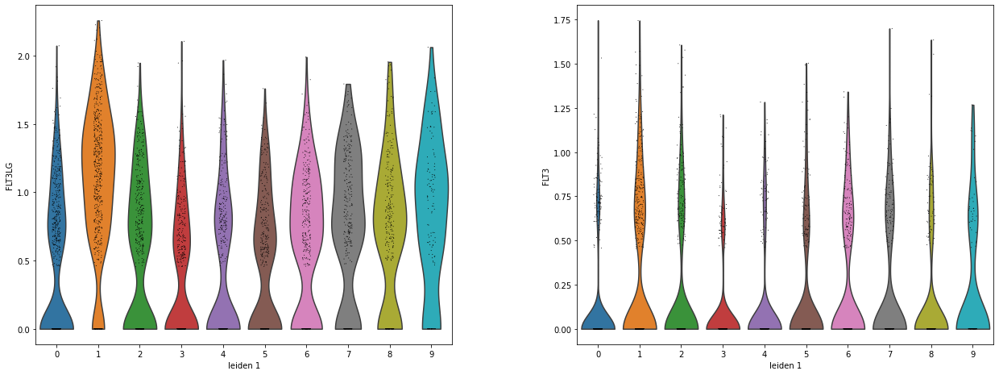

In [142]:
sc.pl.violin(visiumLN, keys=['FLT3LG', 'FLT3'], groupby='leiden_1' )

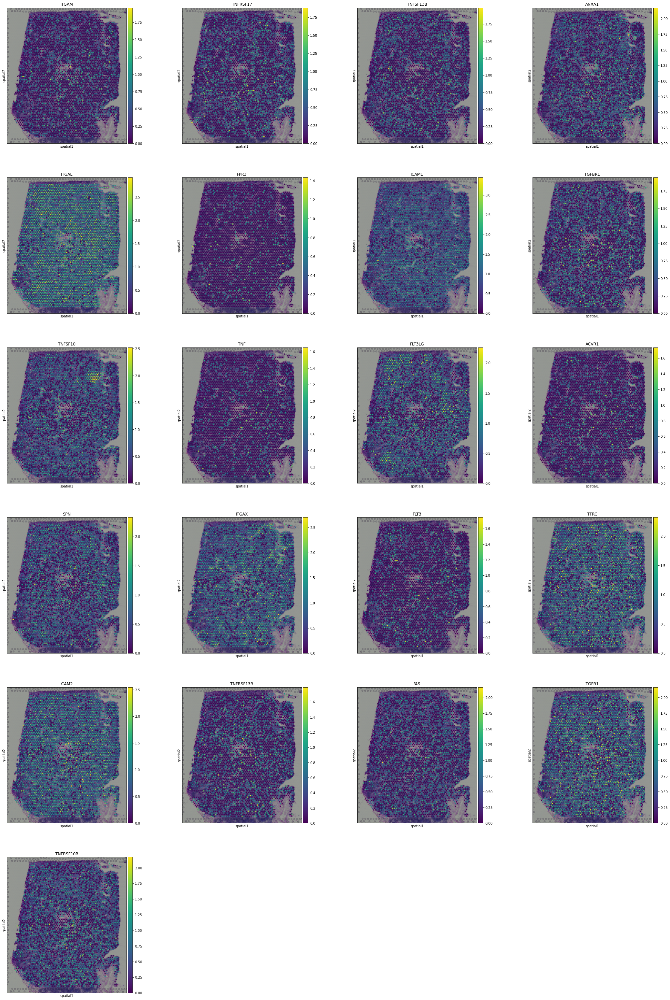

In [79]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=genes_of_interest)

In [80]:
intersection_set_self

{('ANXA1', 'FPR3'),
 ('FLT3LG', 'FLT3'),
 ('ICAM1', 'ITGAL'),
 ('ICAM1', 'ITGAM'),
 ('ICAM1', 'ITGAX'),
 ('ICAM1', 'SPN'),
 ('ICAM2', 'ITGAL'),
 ('TGFB1', 'ACVR1'),
 ('TGFB1', 'TGFBR1'),
 ('TNF', 'FAS'),
 ('TNFSF10', 'TNFRSF10B'),
 ('TNFSF13B', 'TFRC'),
 ('TNFSF13B', 'TNFRSF13B'),
 ('TNFSF13B', 'TNFRSF17')}

In [81]:
visiumLN

AnnData object with n_obs × n_vars = 3861 × 19685
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'leiden_1'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'spatial', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_1_colors'
    obsm: 'spatial', 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [82]:
visiumLN.obsp

PairwiseArrays with keys: distances, connectivities

Questions:  
    1. Is the interaction really true?  
    2. What do the ligrec results mean?  
    3. Plot a Venn Diagram  
    4. identify similar clusters based on similar ligrec results?  
    5. Plot these ligrecs  
    

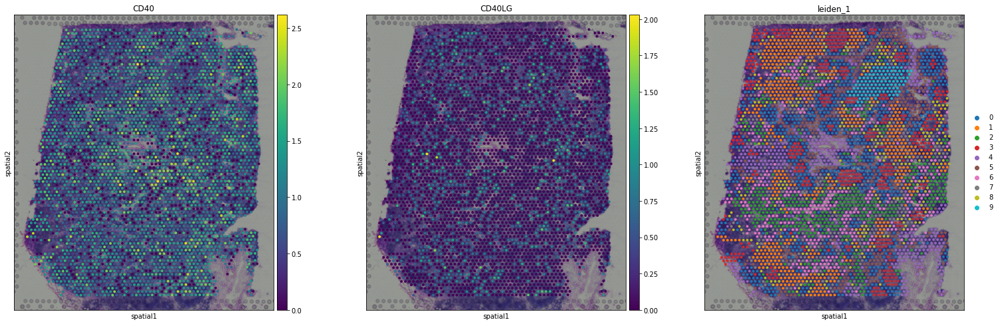

In [83]:
plt.rcParams["figure.figsize"] = (8, 8)
sc.pl.spatial(visiumLN, img_key="hires", color=["CD40", "CD40LG", "leiden_1"])

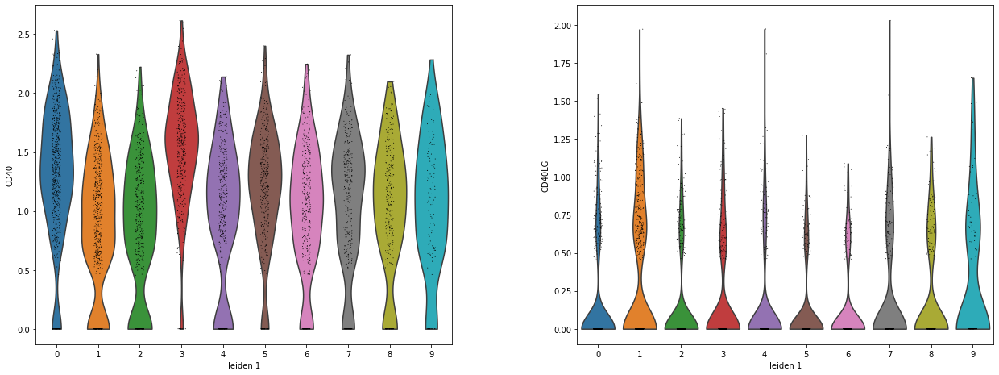

In [84]:
sc.pl.violin(visiumLN, ['CD40', 'CD40LG'], groupby='leiden_1' )

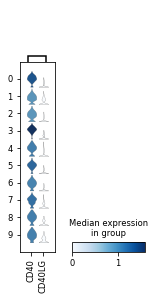

In [85]:
marker_genes_dict = {'': ['CD40', 'CD40LG']}
sc.pl.stacked_violin(visiumLN, marker_genes_dict, 'leiden_1', dendrogram=False)